In [1]:
from __future__ import division
from __future__ import print_function
from builtins import zip
from builtins import str
from builtins import map
from builtins import range
from past.utils import old_div
import cv2
try:
    cv2.setNumThreads(1)
except:
    print('Open CV is naturally single threaded')

try:
    if __IPYTHON__:
        print((1))
        # this is used for debugging purposes only. allows to reload classes
        # when changed
        get_ipython().magic('load_ext autoreload')
        get_ipython().magic('autoreload 2')
except NameError:
    print('Not IPYTHON')
    pass

import caiman as cm
import numpy as np
import os
import time
import glob
import matplotlib.pyplot as plt


from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
from caiman.source_extraction.cnmf import cnmf as cnmf
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf.utilities import detrend_df_f
from caiman.components_evaluation import estimate_components_quality_auto
import bokeh.plotting as bpl
bpl.output_notebook()

1


/home/deisseroth/venv3/local/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


Loading BokehJS ...

In [2]:
# TODO:
# add motion correction
# refactor into files
# add more V1 statistics
# change save-out path
# interface/code for marking bad cells for deletion/merge

In [8]:
movie_name = '/media/deisseroth/Data2/Data/COSMOS/2P/20180201/m72_vis_stim/fov4_vid2/fov4_vid2_000_010.sbx'
stim_name = '/media/deisseroth/Data2/Data/COSMOS/2P/20180201/m72_vis_stim/fov4_vid2/fov4_vid2_000_010.mat'

# dataset dependent parameters
fname = [movie_name]                # filename to be processed
fr = 30                             # imaging rate in frames per second
decay_time = 0.4                    # length of a typical transient in seconds

# motion correction parameters
niter_rig = 1               # number of iterations for rigid motion correction
max_shifts = (6, 6)         # maximum allow rigid shift
splits_rig = 56             # for parallelization split the movies in  num_splits chuncks across time
strides = (48, 48)          # start a new patch for pw-rigid motion correction every x pixels
overlaps = (24, 24)         # overlap between pathes (size of patch strides+overlaps)
splits_els = 56             # for parallelization split the movies in  num_splits chuncks across time
upsample_factor_grid = 4    # upsample factor to avoid smearing when merging patches
max_deviation_rigid = 3     # maximum deviation allowed for patch with respect to rigid shifts

# parameters for source extraction and deconvolution
p = 1                       # order of the autoregressive system
gnb = 2                     # number of global background components
merge_thresh = 0.8          # merging threshold, max correlation allowed
rf = 15                     # half-size of the patches in pixels. e.g., if rf=25, patches are 50x50
stride_cnmf = 6             # amount of overlap between the patches in pixels
K = 4                       # number of components per patch
gSig = [5, 5]               # expected half size of neurons
init_method = 'greedy_roi'  # initialization method (if analyzing dendritic data using 'sparse_nmf')
is_dendrites = False        # flag for analyzing dendritic data
alpha_snmf = None           # sparsity penalty for dendritic data analysis through sparse NMF

# parameters for component evaluation
min_SNR = 2.5               # signal to noise ratio for accepting a component
rval_thr = 0.8              # space correlation threshold for accepting a component
cnn_thr = 0.8               # threshold for CNN based classifier

In [9]:
m_orig = cm.load_movie_chain(fname[:1])
downsample_ratio = 0.2
offset_mov = -np.min(m_orig[:100])  # make the dataset mostly non-negative
#m_orig.resize(1, 1, downsample_ratio).play(gain=10, offset=offset_mov, fr=30, magnification=2)

  0%|          | 0/1 [00:00<?, ?it/s]

sbx


100%|██████████| 1/1 [00:49<00:00, 49.53s/it]


In [10]:
# start the cluster
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)

Exception: A cluster is already runnning. Terminate with dview.terminate() if you want to restart.

# Motion correction

In [14]:
"""
# first we create a motion correction object with the parameters specified
min_mov = cm.load(fname[0], subindices=range(200)).min() 
        # this will be subtracted from the movie to make it non-negative 

mc = MotionCorrect(fname[0], min_mov,
                   dview=dview, max_shifts=max_shifts, niter_rig=niter_rig,
                   splits_rig=splits_rig, 
                   strides= strides, overlaps= overlaps, splits_els=splits_els,
                   upsample_factor_grid=upsample_factor_grid,
                   max_deviation_rigid=max_deviation_rigid, 
                   shifts_opencv = True, nonneg_movie = True)
# note that the file is not loaded in memory
"""

'\n# first we create a motion correction object with the parameters specified\nmin_mov = cm.load(fname[0], subindices=range(200)).min() \n        # this will be subtracted from the movie to make it non-negative \n\nmc = MotionCorrect(fname[0], min_mov,\n                   dview=dview, max_shifts=max_shifts, niter_rig=niter_rig,\n                   splits_rig=splits_rig, \n                   strides= strides, overlaps= overlaps, splits_els=splits_els,\n                   upsample_factor_grid=upsample_factor_grid,\n                   max_deviation_rigid=max_deviation_rigid, \n                   shifts_opencv = True, nonneg_movie = True)\n# note that the file is not loaded in memory\n'

In [15]:
"""
mc.motion_correct_pwrigid(save_movie=True)
m_els = cm.load(mc.fname_tot_els)
bord_px_els = np.ceil(np.maximum(np.max(np.abs(mc.x_shifts_els)),
                                 np.max(np.abs(mc.y_shifts_els)))).astype(np.int)  
"""

'\nmc.motion_correct_pwrigid(save_movie=True)\nm_els = cm.load(mc.fname_tot_els)\nbord_px_els = np.ceil(np.maximum(np.max(np.abs(mc.x_shifts_els)),\n                                 np.max(np.abs(mc.y_shifts_els)))).astype(np.int)  \n'

# Run analysis

In [13]:
#%% MEMORY MAPPING
border_to_0 = 10     # number of pixels to exclude
fname_new = cm.save_memmap(fname, base_name='memmap_', order = 'C',
                           border_to_0 = border_to_0) # exclude borders

# now load the file
Yr, dims, T = cm.load_memmap(fname_new)
d1, d2 = dims
images = np.reshape(Yr.T, [T] + list(dims), order='F') 
    #load frames in python format (T x X x Y)

sbx


In [16]:
#%% restart cluster to clean up memory
dview.terminate()
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)

(21999, 31, 31)
using 1 processes
(21999, 31, 31)
using 225 pixels per process
using 1 processes
using 5000 block_size
using 225 pixels per process
preprocessing ...
checking if missing data
using 5000 block_size
preprocessing ...
(21999, 31, 31)
checking if missing data
(21999, 31, 31)
using 1 processes
using 1 processes
using 225 pixels per process
using 5000 block_size
using 225 pixels per process
preprocessing ...
using 5000 block_size
checking if missing data
preprocessing ...
checking if missing data
(21999, 31, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
(21999, 31, 31)
checking if missing data
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
(21999, 31, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
(21999, 31, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
c

using 5000 block_size
preprocessing ...
checking if missing data
initializing ...
(21999, 31, 31)
Noise Normalization
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
Spatial Downsampling 2-photon
reshaping along x and y
checking if missing data
(10999, 15)
initializing ...
Spatial Downsampling 2-photon
Noise Normalization
initializing ...
Spatial Downsampling 2-photon
reshaping along x and y
reshaping along x and y
Noise Normalization
(10999, 15)
(10999, 15)
initializing ...
Spatial Downsampling 2-photon
Noise Normalization
reshaping along x and y
Spatial Downsampling 2-photon
(10999, 15)
initializing ...
reshaping along x and y
(21999, 31, 31)
Noise Normalization
(10999, 15)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
reshaping along z
Spatial Downsampling 2-photon
reshaping along x and y
Spatial Downsampling 2-photon
(10999, 15)
reshaping along z
reshaping along z
reshaping alon

initializing ...
preprocessing ...
Noise Normalization
checking if missing data
Spatial Downsampling 2-photon
reshaping along x and y
Spatial Downsampling 2-photon
initializing ...
reshaping along x and y
Noise Normalization
(10999, 15)
(10999, 15)
initializing ...
initializing ...
Noise Normalization
Noise Normalization
Spatial Downsampling 2-photon
reshaping along x and y
(21999, 31, 31)
initializing ...
(10999, 15)
using 1 processes
Noise Normalization
using 225 pixels per process
using 5000 block_size
preprocessing ...
Spatial Downsampling 2-photon
checking if missing data
reshaping along x and y
(10999, 15)
Spatial Downsampling 2-photon
reshaping along z
reshaping along x and y
Spatial Downsampling 2-photon
(10999, 15)
(21999, 31, 30)
reshaping along x and y
reshaping along z
(10999, 15)
using 1 processes
using 225 pixels per process
using 5000 block_size
reshaping along z
preprocessing ...
checking if missing data
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatia

checking if missing data
Spatial Downsampling 2-photon
initializing ...
reshaping along x and y
(10999, 15)
Noise Normalization
initializing ...
reshaping along z
Noise Normalization
USING ROLLING SUM FOR INITIALIZATION....
USING ROLLING SUM FOR INITIALIZATION....
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
USING ROLLING SUM FOR INITIALIZATION....
Spatial Downsampling 2-photon
reshaping along x and y
Spatial Downsampling 2-photon
initializing ...
reshaping along x and y
(10999, 15)
(10999, 15)
initializing ...
Noise Normalization
Noise Normalization
reshaping along z
***** OPENCV!!!!
Roi Extraction...
Spatial Downsampling 2-photon
(21999, 31, 31)
reshaping along x and y
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
(10999, 15)
using 1 processes
Spatial Downsampling 2-photon
using 225 pixels per process
using 5000 block_size
reshaping along x and y
(10999, 15)
pre

using 5000 block_size
preprocessing ...
preprocessing ...
checking if missing data
checking if missing data
(21999, 31, 31)
using 1 processes
reshaping along z
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
initializing ...
Noise Normalization
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
USING ROLLING SUM FOR INITIALIZATION....
initializing ...
Noise Normalization
initializing ...
Spatial Downsampling 2-photon
reshaping along x and y
Noise Normalization
(10999, 15)
initializing ...
(21999, 31, 31)
using 1 processes
using 225 pixels per process
Noise Normalization
USING ROLLING SUM FOR INITIALIZATION....
Spatial Downsampling 2-photon
using 5000 block_size
preprocessing ...
checking if missing data
Spatial Downsampling 2-photon
reshaping along x and y
reshaping along x and y
(Hals) Refining Components...
(10999, 15)
(10999, 15)
USING ROLLING SUM FOR INITIALIZATIO

preprocessing ...
Spatial Downsampling 2-photon
checking if missing data
parallel dot product block size: 1000
reshaping along x and y
(10999, 15)
Noise Normalization
Start product
Transposing
Spatial Downsampling 2-photon
reshaping along x and y
960
reshaping along z
reshaping along z
(10999, 15)
Spatial Downsampling 2-photon
(21999, 31, 30)
reshaping along z
reshaping along x and y
***** OPENCV!!!!
***** OPENCV!!!!
using 1 processes
(10999, 15)
Roi Extraction...
using 225 pixels per process
Roi Extraction...
using 5000 block_size
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
preprocessing ...
checking if missing data
initializing ...
***** OPENCV!!!!
reshaping along z
Roi Extraction...
Noise Normalization
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
***** OPENCV!!!!
reshaping along z
Roi Extraction...
Greedy

preprocessing ...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
checking if missing data
parallel dot product block size: 1000
***** OPENCV!!!!
Roi Extraction...
Start product
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
***** OPENCV!!!!
Transposing
Roi Extraction...
960
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Spatial Downsampling 2-photon
reshaping along x and y
(10999, 15)
initializing ...
reshaping along z
Noise Normalization
initializing ...
Noise Normalization
***** OPENCV!!!!
parallel dot product block size: 1000
Roi Extraction...
Start product
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Spatial Downsampling 2-photon
Transposing
initializing ...
Noise Normalization
reshaping along x and y
960
(10999, 15)
Spatial Downsampling 2-photon
reshaping along x and y
reshaping along z
(10999, 15)
***** OPENC

checking if missing data
Spatial Downsampling 2-photon
Start product
(Hals) Refining Components...
initializing ...
reshaping along x and y
(10999, 15)
Noise Normalization
initializing ...
Transposing
Noise Normalization
960
Spatial Downsampling 2-photon
reshaping along x and y
(10999, 15)
USING ROLLING SUM FOR INITIALIZATION....
Spatial Downsampling 2-photon
Spatial Downsampling 2-photon
reshaping along x and y
(10999, 15)
reshaping along x and y
parallel dot product block size: 1000
(10999, 15)
initializing ...
Start product
Transposing
960
Noise Normalization
initializing ...
reshaping along z
Noise Normalization
reshaping along z
Spatial Downsampling 2-photon
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
reshaping along x and y
(10999, 15)
***** OPENCV!!!!
Spatial Downsampling 2-photon
parallel dot product block size: 1000
reshaping along z
Roi Extraction...
reshaping along x and y
Greedy initialization 

reshaping along x and y
(10999, 15)
(21999, 31, 31)
reshaping along z
using 1 processes
Spatial Downsampling 2-photon
using 225 pixels per process
reshaping along x and y
(10999, 15)
using 5000 block_size
preprocessing ...
checking if missing data
reshaping along z
***** OPENCV!!!!
Roi Extraction...
(21999, 31, 31)
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
using 1 processes
USING ROLLING SUM FOR INITIALIZATION....
using 225 pixels per process
***** OPENCV!!!!
parallel dot product block size: 1000
using 5000 block_size
preprocessing ...
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Start product
reshaping along z
checking if missing data
Transposing
960
parallel dot product block size: 1000
initializing ...
Noise Normalization
Start product
parallel dot product block size: 1000
Start product
***** OPENCV!!!!
Transposing
Transposing
Roi Extraction...
960
960
Greedy initialization

Roi Extraction...
(21999, 31, 31)
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
using 1 processes
using 225 pixels per process
using 5000 block_size
(Hals) Refining Components...
USING ROLLING SUM FOR INITIALIZATION....
preprocessing ...
checking if missing data
reshaping along z
(21999, 31, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
***** OPENCV!!!!
checking if missing data
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
(Hals) Refining Components...
(21999, 31, 31)
using 1 processes
parallel dot product block size: 1000
using 225 pixels per process
using 5000 block_size
Start product
preprocessing ...
Transposing
checking if missing data
(21999, 31, 31)
USING ROLLING SUM FOR INITIALIZATION....
using 1 processes
960
using 225 pixels per process
initializing ...
Noise Normalization
using 5000 block_size
preprocessing ...
checking if mis

reshaping along x and y
(10999, 15)
(10999, 15)
USING ROLLING SUM FOR INITIALIZATION....
(Hals) Refining Components...
parallel dot product block size: 1000
Start product
Transposing
960
reshaping along z
reshaping along z
(21999, 31, 31)
***** OPENCV!!!!
parallel dot product block size: 1000
Roi Extraction...
using 1 processes
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
using 225 pixels per process
Start product
Transposing
***** OPENCV!!!!
(21999, 31, 31)
using 1 processes
Roi Extraction...
960
using 5000 block_size
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
using 225 pixels per process
preprocessing ...
using 5000 block_size
checking if missing data
preprocessing ...
checking if missing data
(21999, 31, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
(Hals) Refining Components...
(21999, 31, 31)
initializing ...
using 1 proc

Transposing
960
(Hals) Refining Components...
parallel dot product block size: 1000
USING ROLLING SUM FOR INITIALIZATION....
Start product
Transposing
960
initializing ...
reshaping along z
Noise Normalization
***** OPENCV!!!!
Roi Extraction...
(Hals) Refining Components...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
USING ROLLING SUM FOR INITIALIZATION....
Spatial Downsampling 2-photon
reshaping along x and y
(10999, 15)
(21999, 31, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
parallel dot product block size: 1000
Start product
Transposing
(21999, 31, 31)
960
using 1 processes
reshaping along z
using 225 pixels per process
using 5000 block_size
(21999, 31, 31)
preprocessing ...
checking if missing data
***** OPENCV!!!!
using 1 processes
Roi Extraction...
(21999, 31, 31)
using 225 pixels per process
initializing ...
Noise Normalization
using 1 processes
Greedy initializa

preprocessing ...
(10999, 15)
(21999, 31, 31)
using 1 processes
checking if missing data
using 225 pixels per process
using 5000 block_size
(Hals) Refining Components...
preprocessing ...
checking if missing data
reshaping along z
parallel dot product block size: 1000
Start product
Transposing
initializing ...
960
Noise Normalization
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
initializing ...
(Hals) Refining Components...
Noise Normalization
Spatial Downsampling 2-photon
reshaping along x and y
(10999, 15)
(21999, 31, 31)
(Hals) Refining Components...
using 1 processes
using 225 pixels per process
(21999, 31, 31)
using 5000 block_size
preprocessing ...
using 1 processes
parallel dot product block size: 1000
using 225 pixels per process
checking if missing data
using 5000 block_size
Spatial Downsampling 2-photon
Start product
reshaping along x and y
preprocessing ...
(10999, 15)
Transposing
960
checking if

preprocessing ...
checking if missing data
***** OPENCV!!!!
reshaping along z
reshaping along z
(21999, 31, 31)
Roi Extraction...
(Hals) Refining Components...
using 1 processes
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
(Hals) Refining Components...
***** OPENCV!!!!
***** OPENCV!!!!
using 225 pixels per process
Roi Extraction...
using 5000 block_size
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
preprocessing ...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
checking if missing data
(Hals) Refining Components...
initializing ...
Noise Normalization
(21999, 31, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
USING ROLLING SUM FOR INITIALIZATION....
(Hals) Refining Components...
Spatial Downsampling 2-photon
reshaping along x and y
initializing ...
(10999, 15)
Noise Nor

Noise Normalization
using 5000 block_size
preprocessing ...
checking if missing data
***** OPENCV!!!!
reshaping along z
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
reshaping along z
***** OPENCV!!!!
(21999, 31, 31)
***** OPENCV!!!!
using 1 processes
Roi Extraction...
Spatial Downsampling 2-photon
Roi Extraction...
using 225 pixels per process
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
using 5000 block_size
preprocessing ...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
reshaping along x and y
checking if missing data
(10999, 15)
reshaping along z
***** OPENCV!!!!
(Hals) Refining Components...
Roi Extraction...
initializing ...
Noise Normalization
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
(21999, 31, 30)
using 1 processes
parallel dot product block size: 1000
initializing ...
using 225 p

initializing ...
initializing ...
reshaping along z
Noise Normalization
initializing ...
Noise Normalization
Noise Normalization
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Spatial Downsampling 2-photon
Spatial Downsampling 2-photon
Spatial Downsampling 2-photon
parallel dot product block size: 1000
reshaping along x and y
reshaping along x and y
reshaping along x and y
(10999, 15)
(10999, 15)
Start product
initializing ...
Transposing
(10999, 15)
Noise Normalization
(21999, 31, 31)
960
(21999, 31, 31)
using 1 processes
parallel dot product block size: 1000
using 1 processes
using 225 pixels per process
Start product
Transposing
using 225 pixels per process
using 5000 block_size
preprocessing ...
960
using 5000 block_size
checking if missing data
Spatial Downsampling 2-photon
reshaping along x and y
preprocessing ...
checking if missing data
(10999, 15)
reshaping along z
reshaping along z
(Hals) Refining C

using 1 processes
using 225 pixels per process
using 5000 block_size
initializing ...
reshaping along z
(Hals) Refining Components...
preprocessing ...
Noise Normalization
USING ROLLING SUM FOR INITIALIZATION....
initializing ...
Noise Normalization
checking if missing data
***** OPENCV!!!!
Roi Extraction...
reshaping along z
parallel dot product block size: 1000
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Start product
parallel dot product block size: 1000
(21999, 31, 31)
Transposing
Start product
Transposing
***** OPENCV!!!!
Roi Extraction...
using 1 processes
960
using 225 pixels per process
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Spatial Downsampling 2-photon
using 5000 block_size
reshaping along x and y
preprocessing ...
960
Spatial Downsampling 2-photon
reshaping along x and y
checking if missing data
(10999, 15)
(10999, 15)
(21999, 31, 31)
using 1 processes
using 225 pixels per proces

929
Start product
Transposing
initializing ...
Noise Normalization
960
parallel dot product block size: 1000
Start product
Transposing
960
Spatial Downsampling 2-photon
initializing ...
reshaping along x and y
USING ROLLING SUM FOR INITIALIZATION....
Spatial Downsampling 2-photon
Noise Normalization
reshaping along x and y
(10999, 15)
(10999, 15)
initializing ...
Noise Normalization
(21999, 31, 31)
using 1 processes
Spatial Downsampling 2-photon
using 225 pixels per process
reshaping along x and y
using 5000 block_size
(10999, 15)
preprocessing ...
checking if missing data
Spatial Downsampling 2-photon
reshaping along x and y
(10999, 15)
(21999, 31, 31)
using 1 processes
using 225 pixels per process
reshaping along z
using 5000 block_size
preprocessing ...
checking if missing data
reshaping along z
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spati

929
parallel dot product block size: 1000
Transposing
reshaping along x and y
960
Start product
(10999, 15)
Transposing
960
Spatial Downsampling 2-photon
USING ROLLING SUM FOR INITIALIZATION....
reshaping along x and y
(10999, 15)
(21999, 30, 31)
using 1 processes
using 225 pixels per process
initializing ...
using 5000 block_size
initializing ...
preprocessing ...
Noise Normalization
Noise Normalization
checking if missing data
reshaping along z
parallel dot product block size: 1000
Start product
***** OPENCV!!!!
(21999, 30, 31)
Roi Extraction...
using 1 processes
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Transposing
using 225 pixels per process
960
reshaping along z
using 5000 block_size
preprocessing ...
Spatial Downsampling 2-photon
***** OPENCV!!!!
checking if missing data
Spatial Downsampling 2-photon
reshaping along x and y
Roi Extraction...
reshaping along x and y
(10999, 15)
(10999, 15)
Greedy initialization of spatial and tempor

Noise Normalization
reshaping along z
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Spatial Downsampling 2-photon
reshaping along x and y
(10999, 15)
reshaping along z
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
parallel dot product block size: 1000
Start product
Transposing
929
(Hals) Refining Components...
(Hals) Refining Components...
USING ROLLING SUM FOR INITIALIZATION....
(Hals) Refining Components...
USING ROLLING SUM FOR INITIALIZATION....
parallel dot product block size: 1000
Start product
Transposing
929
parallel dot product block size: 1000
Start product
Transposing
929
(21999, 30, 31)
using 1 processes
using 225 pixels per process
parallel dot product block size: 1000
Start product
using 5000 block_size
preprocessing ...
Transposing
checking if missing data
960
(Hals) Refining Components...
initializing ...
Noise Nor

using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
Spatial Downsampling 2-photon
reshaping along x and y
(10999, 15)
(21999, 30, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
initializing ...
Noise Normalization
initializing ...
Noise Normalization
reshaping along z
(Hals) Refining Components...
(21999, 31, 31)
using 1 processes
using 225 pixels per process
using 5000 block_size
preprocessing ...
checking if missing data
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
Spatial Downsampling 2-photon
reshaping along x and y
Spatial Downsampling 2-photon
(10999, 15)
reshaping along x and y
(10999, 15)
reshaping along z
initializing ...
reshaping along z
Noise Normalization
***** OPENCV!!!!
Roi Extraction...
Greedy initialization of spatial and temporal components using spatial Gaussian filtering
***** O

Process PoolWorker-40:
Process PoolWorker-34:
Process PoolWorker-35:
Process PoolWorker-33:
Process PoolWorker-42:
Process PoolWorker-44:
Process PoolWorker-37:
Process PoolWorker-47:
Process PoolWorker-48:
Process PoolWorker-41:
Process PoolWorker-36:
Process PoolWorker-45:
Process PoolWorker-46:
Process PoolWorker-43:
Process PoolWorker-38:
Process PoolWorker-39:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python2.7/multiprocessing/process.py", line 267, in _bootstrap
Traceback (most recent call last):
  File "/usr/lib/python2.7/multiprocessing/process.py", line 267, in _bootstrap
  File "/usr/lib/

In [18]:
#%% RUN CNMF ON PATCHES

# First extract spatial and temporal components on patches and combine them
# for this step deconvolution is turned off (p=0)
t1 = time.time()

cnm = cnmf.CNMF(n_processes=1, k=K, gSig=gSig, merge_thresh= merge_thresh, 
                p = 0,  dview=dview, rf=rf, stride=stride_cnmf, memory_fact=1,
                method_init=init_method, alpha_snmf=alpha_snmf, 
                only_init_patch = False, gnb = gnb, border_pix = border_to_0) 
cnm = cnm.fit(images)

(21999, 256, 796)
using 1 processes
using 4000 pixels per process
using 5000 block_size
(30, 30)
109.589267969
Transforming patches into full matrix
Skipped %d Empty Patch 0
Generating background
Compressing background components with a low rank NMF


/home/deisseroth/venv3/local/lib/python2.7/site-packages/past/utils/__init__.py:95: RuntimeWarning: divide by zero encountered in divide
  return a / b


Generating background DONE
merging


/home/deisseroth/venv3/local/lib/python2.7/site-packages/scipy/sparse/compressed.py:742: SparseEfficiencyWarning: Changing the sparsity structure of a csc_matrix is expensive. lil_matrix is more efficient.
  SparseEfficiencyWarning)


[  12   13   14 ... 1317 1318 1319]
[840 844]
[604 608]
[24 35]
No neurons merged!
update temporal
Generating residuals
parallel dot product block size: 5000
Start product
Processed:[0, 20]
Transposing
Processed:[20, 40]
Transposing
Processed:[40, 41]
Transposing
entering the deconvolution 
14 out of total 37 temporal components updated
23 out of total 37 temporal components updated
31 out of total 37 temporal components updated
35 out of total 37 temporal components updated
37 out of total 37 temporal components updated
14 out of total 37 temporal components updated
23 out of total 37 temporal components updated
31 out of total 37 temporal components updated
35 out of total 37 temporal components updated
37 out of total 37 temporal components updated
stopping: overall temporal component not changing significantly


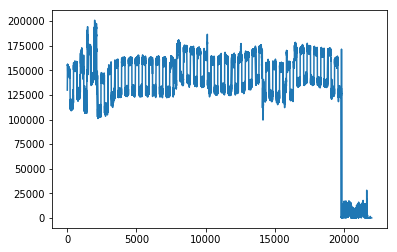

In [26]:
plt.plot(cnm.C[0,:],'.')

In [19]:
#%% plot contours of found components
Cn = cm.local_correlations(images.transpose(1,2,0))
Cn[np.isnan(Cn)] = 0
plt.figure(); crd = plot_contours(cnm.A, Cn, thr=0.9)
plt.title('Contour plots of found components')

/home/deisseroth/Code/CaImAn-master/caiman/summary_images.py:175: RuntimeWarning: invalid value encountered in true_divide
  w_mov = (Y - np.mean(Y, axis=0)) / np.std(Y, axis=0)


KeyboardInterrupt: 

In [10]:
# Cutoffs for excluding bad cells
r_values_min = .7  # threshold on space consistency
fitness_min = -40  # threshold on time variability
fitness_delta_min = -40 # threshold on time variability (if nonsparse activity)
Npeaks = 10

In [11]:
# Exclude bad cells
final_frate = params_movie['final_frate']
traces = C_tot + YrA_tot
idx_components, idx_components_bad = estimate_components_quality(
    traces, Y, A_tot, C_tot, b_tot, f_tot, final_frate=final_frate, 
    Npeaks=Npeaks, r_values_min=r_values_min, fitness_min=fitness_min,
    fitness_delta_min=fitness_delta_min)
print(('Keeping ' + str(len(idx_components)) +
       ' and discarding  ' + str(len(idx_components_bad))))

tB:-5.0,tA:25.0
Computing event exceptionality delta
Removing Baseline
binning data ...
interpolating data ...
(13, 1796)
Computing event exceptionality


/home/deisseroth/Code/CaImAn-master/caiman/components_evaluation.py:141: RuntimeWarning: divide by zero encountered in log
  erf = np.log(erf)


Evaluating spatial footprint
components evaluated:0
components evaluated:200
components evaluated:400
components evaluated:600
Neuron:757 includes overlaping spiking neurons
components evaluated:800
Neuron:808 includes overlaping spiking neurons
components evaluated:1000
components evaluated:1200
components evaluated:1400
Neuron:1588 includes overlaping spiking neurons
components evaluated:1600
Neuron:1617 includes overlaping spiking neurons
Keeping 116 and discarding  1680


In [12]:
# Run CNMF again on whole field of view to refine components
A_tot = A_tot.tocsc()[:, idx_components]
C_tot = C_tot[idx_components]
cnm = cnmf.CNMF(n_processes, k=A_tot.shape, gSig=gSig, 
                merge_thresh=merge_thresh, p=p, dview=dview, Ain=A_tot, Cin=C_tot,
                f_in=f_tot, rf=None, stride=None, method_deconvolution='oasis')
cnm = cnm.fit(images)
A, C, b, f, YrA, sn = cnm.A, cnm.C, cnm.b, cnm.f, cnm.YrA, cnm.sn

(9999, 512, 587)
using 16 processes
using 4000 pixels per process
using 20000 block_size
preprocessing ...
checking if missing data
Running on 16 engines.
update spatial ...
Initializing update of Spatial Components
computing the distance indicators
found spatial support for each component
memmaping
Updating Spatial Components using lasso lars
thresholding components
eliminating 1 empty spatial components
Computing residuals
parallel dot product block size: 1000
Start product
Filling
--- 23.5378708839 seconds ---
Removing tempfiles created
update temporal ...
deconvolution ...
Generating residuals
parallel dot product block size: 20000
Start product
Transposing
19999
39999
59999
79999
99999
119999
139999
159999
179999
199999
219999
239999
259999
279999
299999
300543
entering the deconvolution 
80 out of total 116 temporal components updated
107 out of total 116 temporal components updated
114 out of total 116 temporal components updated
116 out of total 116 temporal components updated


In [13]:
# Higher cutoffs for excluding neurons
r_values_min = .75
fitness_min = - 50
fitness_delta_min = - 50
Npeaks = 10

In [14]:
# Exclude neurons
final_frate = params_movie['final_frate']
traces = C + YrA
idx_components, idx_components_bad = estimate_components_quality(
    traces, Y, A, C, b, f, final_frate=final_frate,
    Npeaks=Npeaks, r_values_min=r_values_min, fitness_min=fitness_min,
    fitness_delta_min=fitness_delta_min)
print(' ***** ')
print((len(traces)))
print((len(idx_components)))
print(len(idx_components_bad))

tB:-5.0,tA:25.0
Computing event exceptionality delta
Removing Baseline
binning data ...
interpolating data ...
(13, 116)
Computing event exceptionality
Evaluating spatial footprint
components evaluated:0
 ***** 
116
89
27


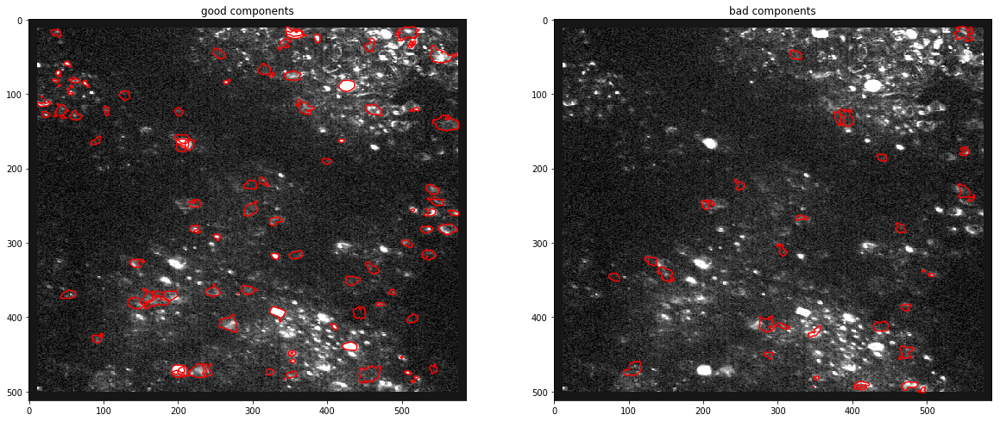

In [15]:
# Visualize included and excluded components
plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
crd = plot_contours(A.tocsc()[:, idx_components], Cn, display_numbers=False, cmap='gray', colors='r')
plt.title('good components')
plt.subplot(1, 2, 2)
crd = plot_contours(A.tocsc()[:, idx_components_bad], Cn, display_numbers=False, cmap='gray', colors='r')
plt.title('bad components')

# Inspect components

In [30]:
np.where(idx_components == 79)

(array([57]),)

In [16]:
# good components
discard_traces_fluo=nb_view_patches(Yr,A.tocsc()[:,idx_components],
                                    C[idx_components],b,f,dims[0],
                                    dims[1],thr = 0.8,image_neurons=Cn,
                                    denoised_color='red')

In [17]:
# bad components
discard_traces_fluo=nb_view_patches(Yr,A.tocsc()[:,idx_components_bad],
                                    C[idx_components_bad],b,f,dims[0],dims[1],
                                    thr = 0.8,image_neurons=Cn, denoised_color='red')

# Save results

In [18]:
# Save results
np.savez(os.path.join(os.path.split(fname_new)[0], 
                      os.path.split(fname_new)[1][:-4] + 'results_analysis.npz'),
         Cn=Cn, A=A.todense(), C=C,
         b=b, f=f, YrA=YrA, sn=sn, d1=d1, d2=d2,
         idx_components=idx_components, idx_components_bad=idx_components_bad)

# Reconstruct denoised movie without background
denoised = cm.movie(A.dot(C)).reshape(dims+(-1,),order = 'F').transpose([2,0,1])
from tifffile import imsave
imsave('denoised-2p.tif', denoised)

# Stop cluster and clean up log files
cm.stop_server()
log_files = glob.glob('*_LOG_*')
for log_file in log_files:
    os.remove(log_file)

Stopping cluster...
NOT SLURM
Waiting for cluster to stop....... done


In [19]:
# Play the denoised movie if desired
# denoised.play(gain = 30, offset = 0, fr =100, magnification = 2)

# Posthoc analysis

In [20]:
def load_grating_onsets(path):
    mat = sio.loadmat(path)
    frames = mat['info'][0][0][0]
    return np.squeeze(frames)

# Get first frame where each grating was presented
frames = load_grating_onsets(stim_name)

In [21]:
# Stimulus information
grating_length = 4
blank_length = 4
nGratings = 8
nTrials = 5

In [22]:
# These are the grating directions
dirs = np.arange(0,360,45)

In [23]:
# Get the raw traces
traces = C + YrA

In [24]:
# The trigger frames are detected at the gray->grating transition indicating grating start
grating_frames = grating_length * final_frate
stim = np.zeros(np.shape(traces)[1])
for frame in frames:
    stim[frame:frame+grating_frames] = 1
    
# Every nGratings we repeat (until nTrials have passed)
first_trial_frames = frames[::nGratings]

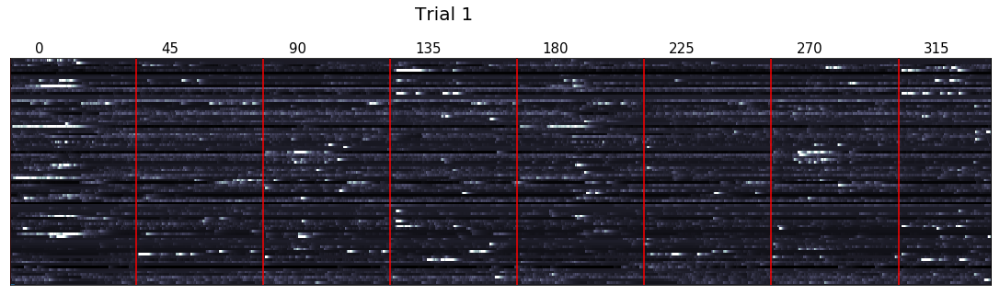

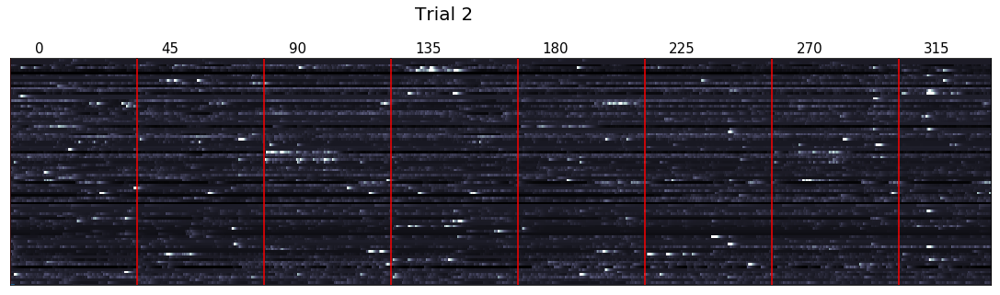

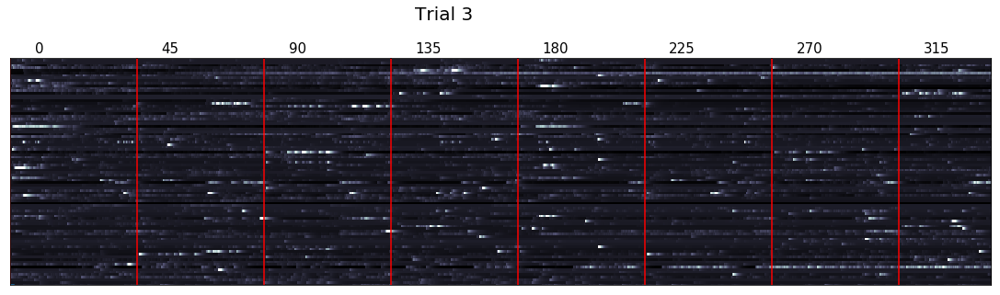

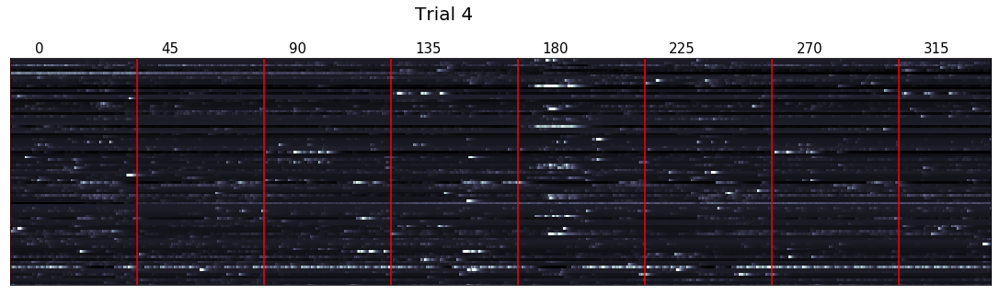

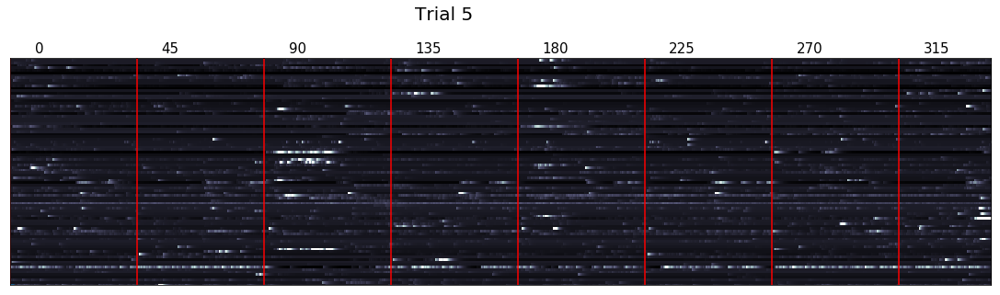

In [26]:
# Get trial-triggered fluorescence
good_only = True
if good_only:
    idx_sorted_display = np.argsort(np.max(C[idx_components,:],1))
else:
    idx_sorted_display = np.argsort(np.max(C[:,:],1))

trial_length = final_frate*nGratings*(grating_length+blank_length)
average_trial_calcium = np.zeros([np.shape(C)[0], trial_length])
trial_calcium = np.zeros([np.shape(C)[0], trial_length, len(first_trial_frames)])
for trial_idx, trial_frame in enumerate(first_trial_frames):
    plt.figure(figsize=(40,10))
    ax=plt.subplot(2,1,1)
    trial_calcium[:, :, trial_idx] = C[:, trial_frame:trial_frame+trial_length]
    plt.imshow(trial_calcium[idx_sorted_display, :, trial_idx],
               aspect=5, vmin=0, vmax=.05, cmap='bone')
    
    average_trial_calcium += trial_calcium[:, :, trial_idx]
    
    start = np.argmin(np.abs(np.float32(frames) - np.float32(trial_frame)))
    plt.plot([frames[start:start+8]-trial_frame,
              frames[start:start+8]-trial_frame],
             [0, len(idx_sorted_display)],'r')
    plt.ylim([0,len(idx_sorted_display)])

    ax.set_yticklabels([])
    ax.set_xticklabels([])
    plt.xticks([])
    plt.yticks([])

    plt.plot(stim[:nGratings]*10)
    for idx in range(len(dirs)):
        plt.text(frames[idx], len(idx_sorted_display)+2, str(dirs[idx]), size=15)
    plt.text(frames[(len(dirs)-1)//2], len(idx_sorted_display)+15,
             'Trial ' + str(trial_idx+1), size=20)

In [27]:
# Find neurons that are correlated with the stimulus
corr_threshold = 0.2
trial_length = nGratings*(grating_length+blank_length)*final_frate
corrs = np.zeros(len(idx_components))
for idx in range(len(corrs)):
    corrs[idx] = np.corrcoef(average_trial_calcium[idx_components[idx],:], stim[:trial_length])[0,1]
idx_good = idx_components[np.where(corrs > corr_threshold)]

In [28]:
# Normalize fluorescence trace
def norm_trace(trace):
    trace = trace - np.min(trace)
    return trace / np.percentile(trace, 99)

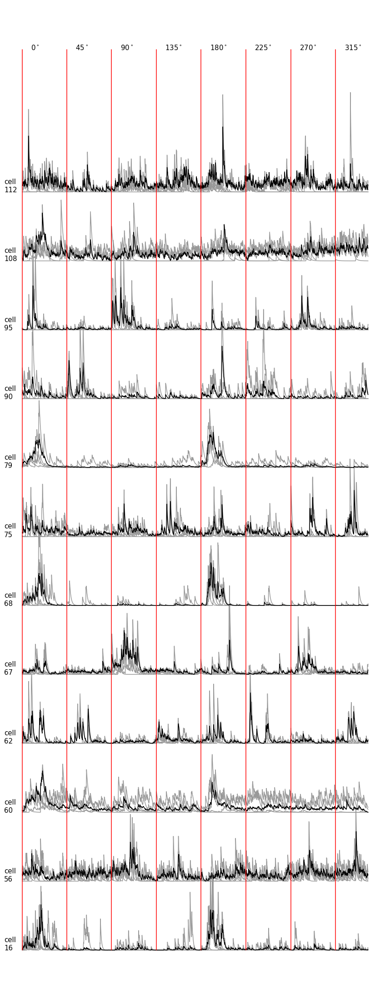

In [29]:
# Plot traces for all neurons correlated with the stimulus
plt.figure(figsize=(15,40))
for ii, idx in enumerate(idx_good):
    for jdx in range(nTrials):
        plt.plot(norm_trace(trial_calcium[idx,:,jdx]) + 2.5*ii, color=[.6, .6, .6])
    plt.plot(norm_trace(average_trial_calcium[idx,:]) + 2.5*ii,color='k')
    plt.text(-100, 2.5*ii+.3, 'cell', size=15)
    plt.text(-100, 2.5*ii, str(idx), size=15)

# Plot trial onset markers
m = plt.ylim()
plt.plot([frames[:8]-frames[0], frames[:8]-frames[0]], [0, m[1]],'r')

# Plot grating direction at top
for idx in range(len(dirs)):
    plt.text(frames[idx], m[1], str(dirs[idx]) + '$^\circ$', size=15)

# Clean up plot
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.xticks([])
plt.yticks([])
plt.box('off')